In [1]:
#%%     
# PLOTTING WITH GEOID, WESTCHESTER SHP NOT FOUND YET, NEED TO BLACK OUT BRROKLYN AND STATEN ISLAND
# Plotting the census tracts for all reports that appeared in a specific month                    
# import contextily as ctx
# import matploylib.pyplot as plt
import geopandas as gp
import os
import platform
import pandas as pd
import numpy as np

# A) CREATING DF AND GDF:
csvFile     = "DataFiles/GasHistory_2010_ReportFrequency_Monthly.csv"
outNYCFile  = "DataFiles/GasHistory_2010_ReportFrequency_Monthly_nycPlot.csv"
outWestFile = "DataFiles/GasHistory_2010_ReportFrequency_Monthly_westchesterPlot.csv"

nycFile         = "ShapeFiles/NYU_NYC_34505_SP/nyu_2451_34505.shp"
brooklynFile    = "ShapeFiles/TIGER_2010_County_Shapefiles/BrooklynCounty_2010SHP/tl_2010_36047_tract10.shp"
statenFile      = "ShapeFiles/TIGER_2010_County_Shapefiles/StatenIslanCounty_2010SHP"
westchesterFile = "ShapeFiles/westchester2010/wctigtrt10.shp"


In [2]:
monthlyDF = pd.read_csv(csvFile)                                                                            # Read the csv file and make a data frame
nycGDF = gp.read_file(nycFile)                                                                           # Read the shape file and make a data frame
brooklynGDF = gp.read_file(brooklynFile)
statenGDF = gp.read_file(statenFile)
westchesterGDF = gp.read_file(westchesterFile)
print(type(nycGDF))
print(type(nycGDF["geometry"]))
print(type(nycGDF["geometry"][0]))


<class 'geopandas.geodataframe.GeoDataFrame'>
<class 'geopandas.geoseries.GeoSeries'>
<class 'shapely.geometry.polygon.Polygon'>


In [3]:
# CHANGE THE CRS SO THAT WESTCHESTER AND NYC ARE ON SAME MAP!
nycCRS = nycGDF.crs
westchesterGDF = westchesterGDF.to_crs(nycCRS)

DF_GEOID_COL  = "GEOID_SCT"
GDF_NYC_GEOID_COL = "tractid"
GDF_West_GEOID_COL = "GEOID10"
GDF_NYC_CENSUS_COL = "namelsad"
GDF_West_CENSUS_COL = "NAMELSAD10"
MIN_NUM_TRACTS_NEEDED_TO_PRINT = 250 #max westchester got in a month is 110


/home/hasan/.local/lib/python3.7/site-packages/pyproj/crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))
/home/hasan/.local/lib/python3.7/site-packages/pyproj/crs.py:77: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method.
  return _prepare_from_string(" ".join(pjargs))


In [4]:
# B1) ADDING NEW COLS TO nycGDF westchesterGDF:    
# B2) CHNAGE DATATYPE OF COLS SO WE CAN COMPARE THEM:
mapArray       = [nycGDF,             westchesterGDF]
geoidColArray  = [GDF_NYC_GEOID_COL,  GDF_West_GEOID_COL]
censusColArray = [GDF_NYC_CENSUS_COL, GDF_West_CENSUS_COL]
for mapt in range(0,len(mapArray)):
    mapArray[mapt]["MonthYear"] = str                                                                                               # adding two new cols to nycGDF
    mapArray[mapt]["TotalMonthlyReport" ] = int
    mapArray[mapt]["CountyName"] = str 
    mapArray[mapt]["CensusBlockID_list"] = str  
    mapArray[mapt]["Ticket_list"] = str  
    mapArray[mapt]["Classification_list"] = str  
    mapArray[mapt]["Zipcode_list"] = str 
    mapArray[mapt]["CountyTract"] = str
    mapArray[mapt][[geoidColArray[mapt]]]   = mapArray[mapt][[geoidColArray[mapt]]].apply(pd.to_numeric).astype(int)                                      # Turning GDF_NYC_GEOID_COL - the CensusTract number to numpy.int64 values so can query them

# print("======================================================================================================== RAW DATA: GDF and monthly DF ========================================================================================================")
# print(nycGDF)
# print("------------------------------------------------------------------------ monthly DF:------------------------------------------")
# print(monthlyDF)
# print("=============================================================================================================== RAW DATA END =================================================================================================================")


In [5]:

# C) CON EDISON DOESNT INCLUDE DATA FROM STATEN ISLAND AND BROOKYLN SO GRAY THEM OUT
# BROOKLYN OUTLINE GDF:
print("\nMaking Brooklyn and Staten Island Outline Maps...")
bkGeoidList = list()
for row in range(0, len(brooklynGDF)):
    bkGeoidList.append(int(brooklynGDF.iloc[row]["GEOID10"]))
brooklynOutlineGDF = nycGDF.copy()
brooklynOutlineGDF.drop(brooklynOutlineGDF.index, inplace=True)  
skipGeoid = []
for geoid in range(0, len(bkGeoidList)):        
    bkGDF = nycGDF.loc[                                                                               # thisMonthsDF = df that contains all rows for that month-year
        (nycGDF[GDF_NYC_GEOID_COL]  == bkGeoidList[geoid]) 
    ]  
    if len(bkGDF)==0:
        print("******************* GEOID "+str(bkGeoidList[geoid])+" is in the Brooklyn County nycFile but is not in NYU NYC nycFile")
    skipGeoid.extend(bkGDF.index.tolist())
    bkGDF = bkGDF.reset_index(drop=True)
    brooklynOutlineGDF = brooklynOutlineGDF.append(bkGDF)
brooklynOutlineGDF.reset_index(drop=True)
# STATEN ISLAND OUTLINE GDF:
print("\nMaking Brooklyn and Staten Island Outline Maps...")
statenGeoidList = list()
for row in range(0, len(statenGDF)):
    statenGeoidList.append(int(statenGDF.iloc[row]["GEOID10"]))
statenOutlineGDF = nycGDF.copy()
statenOutlineGDF.drop(statenOutlineGDF.index, inplace=True)  
skipGeoid = []
for geoid in range(0, len(statenGeoidList)):        
    statenGDF = nycGDF.loc[                                                                               # thisMonthsDF = df that contains all rows for that month-year
        (nycGDF[GDF_NYC_GEOID_COL]  == statenGeoidList[geoid]) 
    ]  
    
    if len(statenGDF)==0:
        print("******************* GEOID "+str(statenGeoidList[geoid])+" is in the Staten Island COunty nycFile but is not in NYU NYC nycFile")
    skipGeoid.extend(statenGDF.index.tolist())
    statenGDF = statenGDF.reset_index(drop=True)
    statenOutlineGDF = statenOutlineGDF.append(statenGDF)
statenOutlineGDF.reset_index(drop=True)



Making Brooklyn and Staten Island Outline Maps...
******************* GEOID 36047990100 is in the Brooklyn County nycFile but is not in NYU NYC nycFile

Making Brooklyn and Staten Island Outline Maps...
******************* GEOID 36085008900 is in the Staten Island COunty nycFile but is not in NYU NYC nycFile
******************* GEOID 36085990100 is in the Staten Island COunty nycFile but is not in NYU NYC nycFile


,tractid,tractnum,name,namelsad,nta,nta_name,bcode,geometry,MonthYear,TotalMonthlyReport,CountyName,CensusBlockID_list,Ticket_list,Classification_list,Zipcode_list,CountyTract
0,36085001700,001700,17,Census Tract 17,SI37,Stapleton-Rosebank,36085,"POLYGON ((960449.8957209368 170254.9269148967,...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>
1,36085000600,000600,6,Census Tract 6,SI37,Stapleton-Rosebank,36085,"POLYGON ((963251.4664423617 167596.0385353833,...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>
2,36085000700,000700,7,Census Tract 7,SI22,West New Brighton-New Brighton-St. George,36085,"POLYGON ((963909.0752025112 174571.6150912484,...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>
3,36085001800,001800,18,Census Tract 18,SI14,Grasmere-Arrochar-Ft. Wadsworth,36085,"POLYGON ((966155.5875470407 159409.8426829397,...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>
4,36085000300,000300,3,Census Tract 3,SI22,West New Brighton-New Brighton-St. George,36085,"POLYGON ((962481.7517949035 173830.7162774376,...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
104,36085012806,012806,128.06,Census Tract 128.06,SI25,Oakwood-Oakwood Beach,36085,"POLYGON ((951155.7548351857 143785.138060621, ...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>
105,36085014607,014607,146.07,Census Tract 146.07,SI54,Great Kills,36085,"POLYGON ((937062.1336548732 143738.0667003377,...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>
106,36085014608,014608,146.08,Census Tract 146.08,SI54,Great Kills,36085,"POLYGON ((939777.2256145731 143961.7503672017,...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>
107,36085017011,017011,170.11,Census Tract 170.11,SI01,Annadale-Huguenot-Prince's Bay-Eltingville,36085,"POLYGON ((935274.9939586923 137823.8693585957,...",<class 'str'>,<class 'int'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>,<class 'str'>


In [6]:
# D) POPULATE THE NEWLY CREATED COLS:
print("\nPopulating new created columns and ploting monthly maps..")
skipMonthIndex = []
count = 0
thisMonthPlot_nycGDF  = nycGDF.copy()
thisMonthPlot_westGDF = westchesterGDF.copy()
allMonth_nycGDF  = []
allMonth_westGDF = []


Populating new created columns and ploting monthly maps..


--------------------------January-2020
coned data - nyc  count: 225          array len: 225
coned data - west count: 124          array len: 124
coned data - total:  349/349
plot nyc len: 225
plot west len: 124
Plot total: 349/349


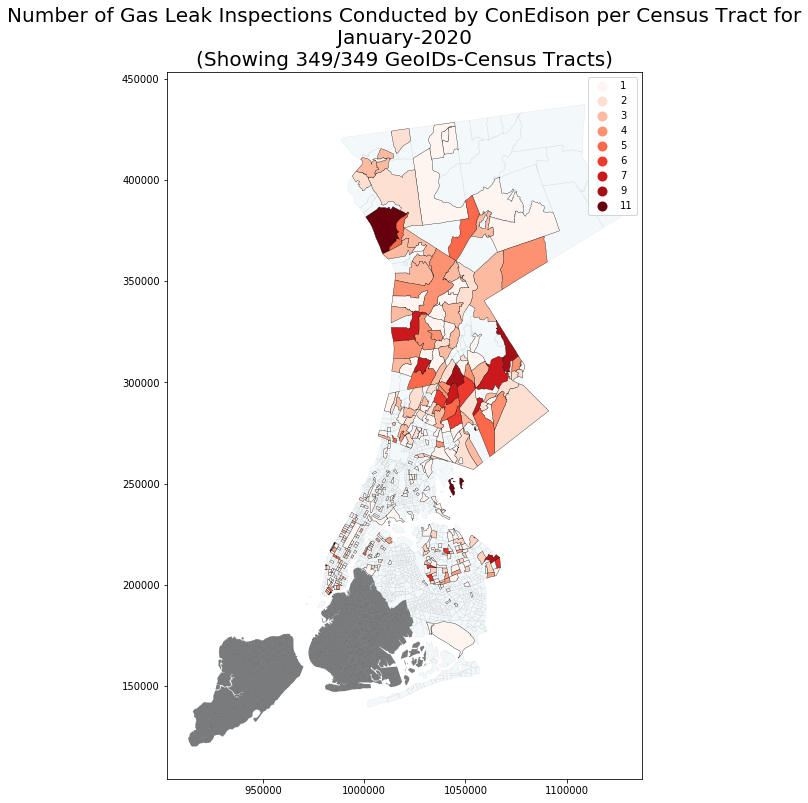

In [7]:

# 0) GO THROUGH EACH ROW OF THE MONTHLY CSV DATA AND PULL OUT ALL ROWS THAT ARE IN THE SAME MONTH -> FROM EACH MINI MONTH SEPERATED DF, SEPERATE FUTHER BY COUNTY NAME -> USE THE GEOID OF EACH COUNTY TO NAME THE GDF FILE
for row in range(0,len(monthlyDF)):
    thisMonthPlot_nycGDF.drop(thisMonthPlot_nycGDF.index, inplace=True)                           # resetting the month df for this new month
    thisMonthPlot_westGDF.drop(thisMonthPlot_westGDF.index, inplace=True) 
    if row in skipMonthIndex:
        continue

    # 1) SAME MONTH SEPERATION:
    thisMonthsDF = monthlyDF.loc[                                                                               # thisMonthsDF = df that contains all rows for that month-year
        (monthlyDF['MonthYear']  == monthlyDF['MonthYear'][row]) 
    ]  
    if len(thisMonthsDF) <= MIN_NUM_TRACTS_NEEDED_TO_PRINT:                                                                                  # If these r no reports for this month-year so skip
        continue
    skipMonthIndex.extend(thisMonthsDF.index.tolist())
    thisMonthsDF = thisMonthsDF.reset_index(drop=True)
    thisMonthGeoList = thisMonthsDF.GEOID_SCT.tolist()                                                          # need to put census tracts into an array, if i use directly from thisMonthsDF i get errors when there is no 
    thisMonthYrStr = monthlyDF['MonthYear'][row]

    # 1.2) CHECKING NUMBER FOR NYC AND WESTCHESTER COUNTY FROM CONED DATA 
    westCount = 0
    west = []
    nycCount = 0
    nyc = []
    for i in range(0,len(thisMonthsDF)):
        if thisMonthsDF.iloc[i]["CountyName_2010"]=="Westchester County":
            westCount = westCount+1
            west.append(thisMonthsDF.iloc[i][DF_GEOID_COL])
        else:
            nycCount = nycCount + 1
            nyc.append(thisMonthsDF.iloc[i][DF_GEOID_COL])
    print("--------------------------"+thisMonthYrStr)
    print("coned data - nyc  count: "+str(nycCount) + "          array len: "+str(len(nyc)))
    print("coned data - west count: "+str(westCount)+ "          array len: "+str(len(west)))
    print("coned data - total:  "+str(nycCount+westCount)+"/"+str(len(thisMonthsDF)))
    
    # 2) FOR CURRENT MONTH -> SEPERATE BY COUNTIES:
    skipCountyIndex = []
    for row2 in range(0,len(thisMonthsDF)):
        if row2 in skipCountyIndex:
            continue
        thisMonthsCountyDF = thisMonthsDF.loc[                                                                               # thisMonthsCountyDF = df that contains all rows for that month-year
            (thisMonthsDF['CountyName_2010']  == thisMonthsDF['CountyName_2010'][row2]) 
        ]      
        if len(thisMonthsCountyDF) == 0:                                                                                  # If these r no reports for this month-year so skip
            print("----------------- NO GEOID FOR THIS COUNTY: "+thisMonthsDF['CountyName_2010'][row2]+" FOR "+thisMonthYrStr)
            continue
        skipCountyIndex.extend(thisMonthsCountyDF.index.tolist())
        thisMonthsCountyDF = thisMonthsCountyDF.reset_index(drop=True)
        thisCountyStr = thisMonthsDF.iloc[row2]["CountyName_2010"]
        
        # 2.2) I HAVE TWO SHAPEFILES (NYC, Westchester). My data has all the counties. Using target index, mapArray[] and geoidColArray[] to choose the shapefile i want
        target = 0
        if thisCountyStr == "Westchester County":
            target = 1
        
        # 3) FOR THE COUNTY -> FIND THE GEOIDS FROM THE SHP AND POPULATE THE COLS
        rowCOunterc = -1
        for row3 in range(0,len(thisMonthsCountyDF)):
            thisMonthsCountyGeoGDF = mapArray[target].loc[                                                                               # thisMonthsCountyDF = df that contains all rows for that month-year
                (mapArray[target][geoidColArray[target]]  == thisMonthsCountyDF[DF_GEOID_COL][row3]) 
            ] 
            if len(thisMonthsCountyGeoGDF) == 0:                                                                                  # If these r no reports for this month-year so skip
                print("----------------- "+ thisMonthYrStr +":        NO GEOID THIS MONTH FOR COUNTY "+thisCountyStr)#+thisMonthsCountyGeoGDF[GDF_NYC_GEOID_COL][row3])
                continue
            thisMonthsCountyGeoGDF  = thisMonthsCountyGeoGDF.reset_index(drop=True)

            # 4) POPULATING THE COLS I ADDED FROM THE MONTHLY CSV DATA FOR THE SAME GEOIDS
            thisMonthsCountyGeoGDF.at[0, "MonthYear"] = thisMonthsCountyDF.loc[row3]["MonthYear"]
            thisMonthsCountyGeoGDF.at[0, "TotalMonthlyReport"] = thisMonthsCountyDF.loc[row3]["TotalReports"]
            thisMonthsCountyGeoGDF.at[0, "CountyName"] = thisMonthsCountyDF.loc[row3]["CountyName_2010"]
            thisMonthsCountyGeoGDF.at[0, "CensusBlockID_list"] = thisMonthsCountyDF.loc[row3]["CensusBlockID_list"]
            thisMonthsCountyGeoGDF.at[0, "Ticket_list"] = thisMonthsCountyDF.loc[row3]["Ticket_list"]
            thisMonthsCountyGeoGDF.at[0, "Classification_list"] = thisMonthsCountyDF.loc[row3]["Classification_list"]
            thisMonthsCountyGeoGDF.at[0, "Zipcode_list"] = thisMonthsCountyDF.loc[row3]["Zipcode_list"]  
            thisMonthsCountyGeoGDF.at[0, "CountyTract"] = thisMonthsCountyGeoGDF.iloc[0]["CountyName"]+"-"+str(thisMonthsCountyGeoGDF.iloc[0][censusColArray[target]]).split(" ")[2]   # Add "CountyName-TractNum" to the col
            if target == 0:
                thisMonthPlot_nycGDF  = thisMonthPlot_nycGDF.append(thisMonthsCountyGeoGDF)
            elif target == 1:
                thisMonthPlot_westGDF = thisMonthPlot_westGDF.append(thisMonthsCountyGeoGDF)
            else:
                print("ISSSSSSSSSSSSSSSUUUUUUUUUUUUUUUUUEEEEEEEEEEEEEEEEEEEEEEE!")
            # print("")
        thisMonthPlot_westGDF = thisMonthPlot_westGDF.reset_index(drop=True)
        thisMonthPlot_nycGDF = thisMonthPlot_nycGDF.reset_index(drop=True)
    print("plot nyc len: "+str(len(thisMonthPlot_nycGDF)))
    print("plot west len: "+str(len(thisMonthPlot_westGDF)))
    print('Plot total: '+str(len(thisMonthPlot_nycGDF)+ len(thisMonthPlot_westGDF))+"/"+str(len(thisMonthsDF)))
    allMonth_nycGDF.append(thisMonthPlot_nycGDF.copy())                    
    allMonth_westGDF.append(thisMonthPlot_westGDF.copy())
    
    # 5) PLOT THE MONTH'S DATA:
    figx = 14
    figy = 13
    ax = nycGDF.plot(alpha=0.05, edgecolor='black', linewidth = 0.6, figsize = (figx,figy))
    ax = brooklynOutlineGDF.plot(alpha=0.5, ax=ax, figsize = (figx,figy), color="black")
    ax = statenOutlineGDF.plot(alpha=0.5, ax=ax, figsize = (figx,figy), color="black")
    
    ax = thisMonthPlot_nycGDF.plot(column='TotalMonthlyReport',cmap = 'Reds', edgecolor='black', linewidth = 0.3, figsize = (figx,figy),legend = True, ax=ax)#, ax=ax, alpha=1) #10,8
    # map.set_title(label = 'Number of Gas Leak Reports per Census Tract for\n{0}\n(Showing {1}/{2} GeoIDs-Census Tracts)\n(Remaining Census Tracts are in Westcester County which isnt Plotted)'.format(thisMonthYrStr, len(thisMonthPlot_nycGDF), len(thisMonthsDF)), fontdict={'fontsize': 20}, loc='center')
    
    ax = westchesterGDF.plot(alpha=0.05, edgecolor='black', linewidth = 0.6, figsize = (figx,figy), ax=ax)
    map = thisMonthPlot_westGDF.plot(column='TotalMonthlyReport',cmap = 'Reds', edgecolor='black', linewidth = 0.3, figsize = (figx,figy),legend = True, ax=ax)#, ax=ax, alpha=1) #10,8
    map.set_title(label = 'Number of Gas Leak Inspections Conducted by ConEdison per Census Tract for\n{0}\n(Showing {1}/{2} GeoIDs-Census Tracts)'.format(thisMonthYrStr, (len(thisMonthPlot_westGDF)+len(thisMonthPlot_nycGDF)), len(thisMonthsDF)), fontdict={'fontsize': 20}, loc='center')
    


In [8]:
# 1a) MAKE WESTCHESTER AND NYC GDF HAVE SAME COLS SO CAN ADD THEM TO MAKE ONE COMPLETE GDF
renameCols = ["Geoid", "CensusTract", "MonthYear", "TotalMonthlyReport",	"CountyName", "geometry"]
nycHeader  = ["tractid", "namelsad", "MonthYear", "TotalMonthlyReport",	"CountyName", "geometry"]
for i in range(0,len(allMonth_nycGDF)):
    allMonth_nycGDF[i] = allMonth_nycGDF[i].filter(nycHeader)
    allMonth_nycGDF[i].columns = renameCols
allMonth_nycGDF[0]

print(type(allMonth_nycGDF[0]))
print(type(allMonth_nycGDF[0]["geometry"]))
print(type(allMonth_nycGDF[0]["geometry"][0]))

<class 'geopandas.geodataframe.GeoDataFrame'>
<class 'geopandas.geoseries.GeoSeries'>
<class 'shapely.geometry.polygon.Polygon'>


In [9]:
#1b) Westchester
westHeader  = ["GEOID10", "NAMELSAD10", "MonthYear", "TotalMonthlyReport",	"CountyName", "geometry"]
for i in range(0,len(allMonth_westGDF)):
    allMonth_westGDF[i] = allMonth_westGDF[i].filter(westHeader)
    allMonth_westGDF[i].columns = renameCols
allMonth_westGDF[0]

,Geoid,CensusTract,MonthYear,TotalMonthlyReport,CountyName,geometry
0,36119981000,Census Tract 9810,January-2020,1,Westchester County,"POLYGON ((1036242.139198904 338158.2964994209,..."
1,36119014811,Census Tract 148.11,January-2020,1,Westchester County,"POLYGON ((1045199.063647221 423899.7591780648,..."
2,36119014810,Census Tract 148.10,January-2020,1,Westchester County,"POLYGON ((1038460.084928317 419460.4050128093,..."
3,36119014806,Census Tract 148.06,January-2020,1,Westchester County,"POLYGON ((1031897.796700109 418892.6583158391,..."
4,36119014805,Census Tract 148.05,January-2020,1,Westchester County,"POLYGON ((1026343.626812236 395582.2422356963,..."
...,...,...,...,...,...,...
119,36119000702,Census Tract 7.02,January-2020,1,Westchester County,"POLYGON ((1015528.524206844 293498.2202234388,..."
120,36119000701,Census Tract 7.01,January-2020,2,Westchester County,"POLYGON ((1017196.026654577 295238.3692094152,..."
121,36119000203,Census Tract 2.03,January-2020,3,Westchester County,"POLYGON ((1012026.72825287 271552.387458927, 1..."
122,36119000202,Census Tract 2.02,January-2020,1,Westchester County,"POLYGON ((1011461.80824416 273975.3531085061, ..."


In [10]:
#2) Make NYC and Westchester into one GDF
allMonth_GDF = allMonth_nycGDF
for i in range(0,len(allMonth_GDF)):
    allMonth_GDF[i] = allMonth_GDF[i].append(allMonth_westGDF[i], ignore_index=True)
for i in range(0,len(allMonth_GDF)):
    allMonth_GDF[i]['GDF_Index'] = allMonth_GDF[i].index      #need the row to match with geojson ids

allMonth_GDF[0]

,Geoid,CensusTract,MonthYear,TotalMonthlyReport,CountyName,geometry,GDF_Index
0,36081161700,Census Tract 1617,January-2020,3,Queens County,"POLYGON ((1061105.246473343 205969.3440770327,...",0
1,36081157903,Census Tract 1579.03,January-2020,1,Queens County,"POLYGON ((1063832.605915026 207684.3044049548,...",1
2,36081157901,Census Tract 1579.01,January-2020,5,Queens County,"POLYGON ((1064521.493063836 211892.4419341416,...",2
3,36081157102,Census Tract 1571.02,January-2020,1,Queens County,"POLYGON ((1059760.018117939 209246.6724621974,...",3
4,36081157101,Census Tract 1571.01,January-2020,2,Queens County,"POLYGON ((1060664.846078629 210989.9258946723,...",4
...,...,...,...,...,...,...,...
344,36119000702,Census Tract 7.02,January-2020,1,Westchester County,"POLYGON ((1015528.524206844 293498.2202234388,...",344
345,36119000701,Census Tract 7.01,January-2020,2,Westchester County,"POLYGON ((1017196.026654577 295238.3692094152,...",345
346,36119000203,Census Tract 2.03,January-2020,3,Westchester County,"POLYGON ((1012026.72825287 271552.387458927, 1...",346
347,36119000202,Census Tract 2.02,January-2020,1,Westchester County,"POLYGON ((1011461.80824416 273975.3531085061, ...",347


In [11]:
print(type(allMonth_GDF[0]))
print(type(allMonth_GDF[0]["geometry"]))
print(type(allMonth_GDF[0]["geometry"][0]))

<class 'geopandas.geodataframe.GeoDataFrame'>
<class 'geopandas.geoseries.GeoSeries'>
<class 'shapely.geometry.polygon.Polygon'>


In [12]:
# 3) Change datatype of cols from numpy to str so can convert to json
# ISSUE: TURNS GDF TO DF
dtypeRenamedCols = { 
    "Geoid":"str", "CensusTract":"str", "MonthYear":"str", "TotalMonthlyReport":"str",	"CountyName":"str"
}
for i in range(0,len(allMonth_GDF)):
    for row in range(0,len(allMonth_GDF[i])):
        allMonth_GDF[i] = allMonth_GDF[i].astype(dtype = dtypeRenamedCols)

typel = []
for col in allMonth_GDF[0]:
    typel.append((col, type(allMonth_GDF[0].iloc[0][col])))
print(typel)
print(type(allMonth_GDF[0]))
print(type(allMonth_GDF[0]["geometry"]))
print(type(allMonth_GDF[0]["geometry"][0]))
allMonth_GDF[0]


[('Geoid', <class 'str'>), ('CensusTract', <class 'str'>), ('MonthYear', <class 'str'>), ('TotalMonthlyReport', <class 'str'>), ('CountyName', <class 'str'>), ('geometry', <class 'shapely.geometry.polygon.Polygon'>), ('GDF_Index', <class 'numpy.int64'>)]
<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>
<class 'shapely.geometry.polygon.Polygon'>


,Geoid,CensusTract,MonthYear,TotalMonthlyReport,CountyName,geometry,GDF_Index
0,36081161700,Census Tract 1617,January-2020,3,Queens County,"POLYGON ((1061105.246473343 205969.3440770327,...",0
1,36081157903,Census Tract 1579.03,January-2020,1,Queens County,"POLYGON ((1063832.605915026 207684.3044049548,...",1
2,36081157901,Census Tract 1579.01,January-2020,5,Queens County,"POLYGON ((1064521.493063836 211892.4419341416,...",2
3,36081157102,Census Tract 1571.02,January-2020,1,Queens County,"POLYGON ((1059760.018117939 209246.6724621974,...",3
4,36081157101,Census Tract 1571.01,January-2020,2,Queens County,"POLYGON ((1060664.846078629 210989.9258946723,...",4
...,...,...,...,...,...,...,...
344,36119000702,Census Tract 7.02,January-2020,1,Westchester County,"POLYGON ((1015528.524206844 293498.2202234388,...",344
345,36119000701,Census Tract 7.01,January-2020,2,Westchester County,"POLYGON ((1017196.026654577 295238.3692094152,...",345
346,36119000203,Census Tract 2.03,January-2020,3,Westchester County,"POLYGON ((1012026.72825287 271552.387458927, 1...",346
347,36119000202,Census Tract 2.02,January-2020,1,Westchester County,"POLYGON ((1011461.80824416 273975.3531085061, ...",347


In [13]:
# 4) IMPORANT: CONVERT THE POLYGON INTO A MULTIPLOYGON!!
from shapely.geometry.polygon import Polygon
from shapely.geometry.multipolygon import MultiPolygon

allMonth_GDF[0]["geometry"] = [MultiPolygon([feature]) if type(feature) == Polygon \
    else feature for feature in allMonth_GDF[0]["geometry"]]

print(type(allMonth_GDF[0]))
print(type(allMonth_GDF[0]["geometry"]))
print(type(allMonth_GDF[0]["geometry"][0]))


<class 'pandas.core.frame.DataFrame'>
<class 'pandas.core.series.Series'>
<class 'shapely.geometry.multipolygon.MultiPolygon'>


In [14]:
# 5) Change df back to gdf
from geopandas import GeoDataFrame
from shapely.geometry import Point

crs = {'init': 'epsg:4326'}

for i in range(0,len(allMonth_GDF)):
    allMonth_GDF[i] = GeoDataFrame(allMonth_GDF[i], crs=crs, geometry=allMonth_GDF[i]["geometry"])

print(type(allMonth_GDF[0]))
print(type(allMonth_GDF[0]["geometry"]))
print(type(allMonth_GDF[0]["geometry"][0]))
allMonth_bGDF[0]

<class 'geopandas.geodataframe.GeoDataFrame'>
<class 'geopandas.geoseries.GeoSeries'>
<class 'shapely.geometry.multipolygon.MultiPolygon'>


,Geoid,CensusTract,MonthYear,TotalMonthlyReport,CountyName,geometry,GDF_Index
0,36081161700,Census Tract 1617,January-2020,3,Queens County,(POLYGON ((1061105.246473343 205969.3440770327...,0
1,36081157903,Census Tract 1579.03,January-2020,1,Queens County,(POLYGON ((1063832.605915026 207684.3044049548...,1
2,36081157901,Census Tract 1579.01,January-2020,5,Queens County,(POLYGON ((1064521.493063836 211892.4419341416...,2
3,36081157102,Census Tract 1571.02,January-2020,1,Queens County,(POLYGON ((1059760.018117939 209246.6724621974...,3
4,36081157101,Census Tract 1571.01,January-2020,2,Queens County,(POLYGON ((1060664.846078629 210989.9258946723...,4
...,...,...,...,...,...,...,...
344,36119000702,Census Tract 7.02,January-2020,1,Westchester County,(POLYGON ((1015528.524206844 293498.2202234388...,344
345,36119000701,Census Tract 7.01,January-2020,2,Westchester County,(POLYGON ((1017196.026654577 295238.3692094152...,345
346,36119000203,Census Tract 2.03,January-2020,3,Westchester County,"(POLYGON ((1012026.72825287 271552.387458927, ...",346
347,36119000202,Census Tract 2.02,January-2020,1,Westchester County,"(POLYGON ((1011461.80824416 273975.3531085061,...",347


In [15]:
# 6) Turn to json, and delete th epoly col from gdf
import json

def returnGeoJSON_fromGDF(gdf):
    jsonStr = json.loads(gdf.to_json())
    json_data = json.dumps(jsonStr)
    jsonDict = json.loads(json_data) 
    return jsonDict

allMonth_GeoDict = []
for i in range(0,len(allMonth_GDF)):
       allMonth_GeoDict.append(returnGeoJSON_fromGDF(allMonth_GDF[i]))
       del allMonth_GDF[i]["geometry"]
allMonth_GDF[0]


,Geoid,CensusTract,MonthYear,TotalMonthlyReport,CountyName,GDF_Index
0,36081161700,Census Tract 1617,January-2020,3,Queens County,0
1,36081157903,Census Tract 1579.03,January-2020,1,Queens County,1
2,36081157901,Census Tract 1579.01,January-2020,5,Queens County,2
3,36081157102,Census Tract 1571.02,January-2020,1,Queens County,3
4,36081157101,Census Tract 1571.01,January-2020,2,Queens County,4
...,...,...,...,...,...,...
344,36119000702,Census Tract 7.02,January-2020,1,Westchester County,344
345,36119000701,Census Tract 7.01,January-2020,2,Westchester County,345
346,36119000203,Census Tract 2.03,January-2020,3,Westchester County,346
347,36119000202,Census Tract 2.02,January-2020,1,Westchester County,347


In [17]:
allMonth_GeoDict[0]

{'type': 'FeatureCollection',
 'features': [{'id': '0',
   'type': 'Feature',
   'properties': {'CensusTract': 'Census Tract 1617',
    'CountyName': 'Queens County',
    'GDF_Index': 0,
    'Geoid': '36081161700',
    'MonthYear': 'January-2020',
    'TotalMonthlyReport': '3'},
   'geometry': {'type': 'MultiPolygon',
    'coordinates': [[[[1061105.2464733429, 205969.34407703273],
       [1061454.9150582145, 205912.16024833263],
       [1061704.9876961692, 205886.36047735708],
       [1062139.9216573958, 205946.77395952365],
       [1062398.110938754, 205982.57967283725],
       [1062661.8447627206, 206017.67737586176],
       [1062915.33166809, 206050.19440931594],
       [1063173.7982466375, 206085.28061265213],
       [1063432.8171902925, 206120.73570542276],
       [1063701.5342876066, 206156.5896349043],
       [1063987.6437321587, 206212.90632346124],
       [1064105.8731484215, 206247.17792822342],
       [1064212.472979906, 206278.13280297277],
       [1064355.1393785314, 20579

In [18]:
import plotly.express as px

fig = px.choropleth_mapbox(
    allMonth_GDF[0],            
    geojson   = allMonth_GeoDict[0],  # geojson-formatted dict must contain Polygon obj whose ids matchs to locations'
    color     = "CountyName",          # GDF column
    locations = "GDF_Index",         # GDF column
    featureidkey = "properties.GDF_Index",
    center = {"lat": 40.730610, "lon":  -73.935242},
    mapbox_style = "carto-positron", 
    zoom = 9
)

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()